In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set(style='white')
%matplotlib inline
from sklearn import decomposition
from sklearn import datasets
from mpl_toolkits.mplot3d import Axes3D

In [2]:
from data_generator import *

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import plotly.graph_objects as go
import plotly.express as px

In [5]:
from sklearn.manifold import TSNE

In [6]:
import umap

In [7]:
from sklearn.preprocessing import StandardScaler

In [8]:
plt.rcParams['figure.figsize'] = (6,6)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['image.origin'] = 'lower'

In [9]:
X1,y1,_,_ = generate_data(cov_matrix=corr_coeff_2_cov_matr(corr_coeff=0.8), epsilon_var=1.3)

In [10]:
X1 = np.concatenate([X1, y1], axis=1)

In [11]:
X1 = X1+np.array([[-0.5, 0.7, 5.3]])

In [12]:
X1.mean(axis=0)

array([-0.50003041,  0.70289056,  7.62740479])

In [13]:
labels1 = np.ones_like

In [14]:
X2,y2,_,_ = generate_data(cov_matrix=corr_coeff_2_cov_matr(corr_coeff=-0.5), epsilon_var=0.5)

In [15]:
X2 = np.concatenate([X2, y2], axis=1)

In [16]:
X2 = X2+np.array([[0.4, -0.4, -0.2]])

In [17]:
X2.mean(axis=0)

array([ 0.38034706, -0.39664829,  2.11920647])

In [18]:
X3,y3,_,_ = generate_data(cov_matrix=corr_coeff_2_cov_matr(corr_coeff=0.2), epsilon_var=0.04)

In [19]:
X3 = np.concatenate([X3, y3], axis=1)

In [20]:
X3 = X3+np.array([[1.2, -1.2, -3.0]])

In [21]:
X3.mean(axis=0)

array([ 1.20737771, -1.20060554, -0.66469853])

In [22]:
X = np.concatenate([X1, X2, X3], axis=0)

In [23]:
X.shape

(30000, 3)

In [24]:
np.corrcoef(X.T)

array([[ 1.        , -0.24963083, -0.4142463 ],
       [-0.24963083,  1.        ,  0.29652781],
       [-0.4142463 ,  0.29652781,  1.        ]])

In [25]:
fig = go.Figure(data=[go.Scatter3d(x=X[:,0],
                                   y=X[:,1],
                                   z=X[:,2],
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x0',
                               yaxis_title='x1',
                               zaxis_title='x2'))
fig.show()

In [26]:
scaled_data = StandardScaler().fit_transform(X)

In [27]:
scaled_data = X

In [28]:
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(scaled_data)

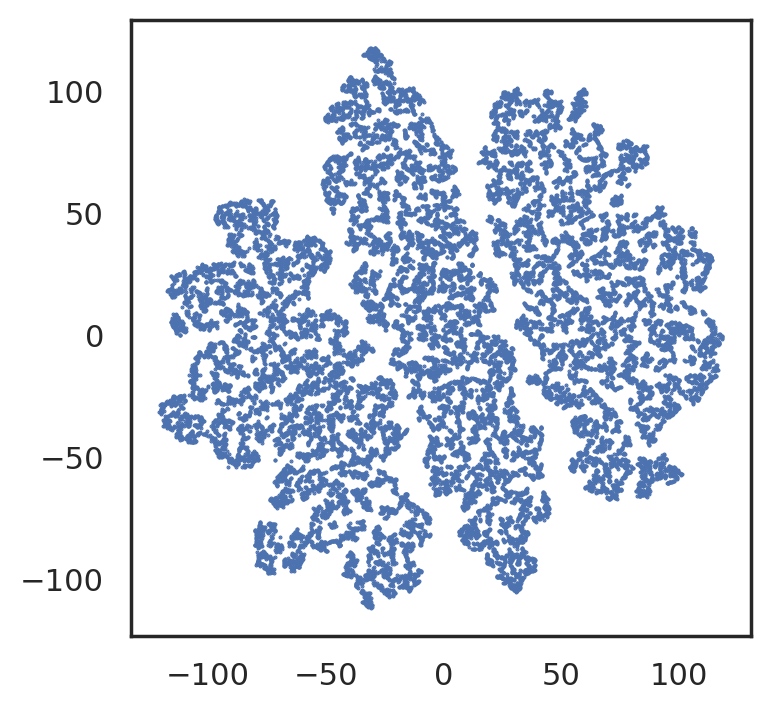

In [29]:
f = plt.figure(figsize=(4,4), dpi=200)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=0.2);

In [30]:
umap_reducer_2d = umap.UMAP(n_components=2)

In [31]:
embeddings_2d = umap_reducer_2d.fit_transform(scaled_data)

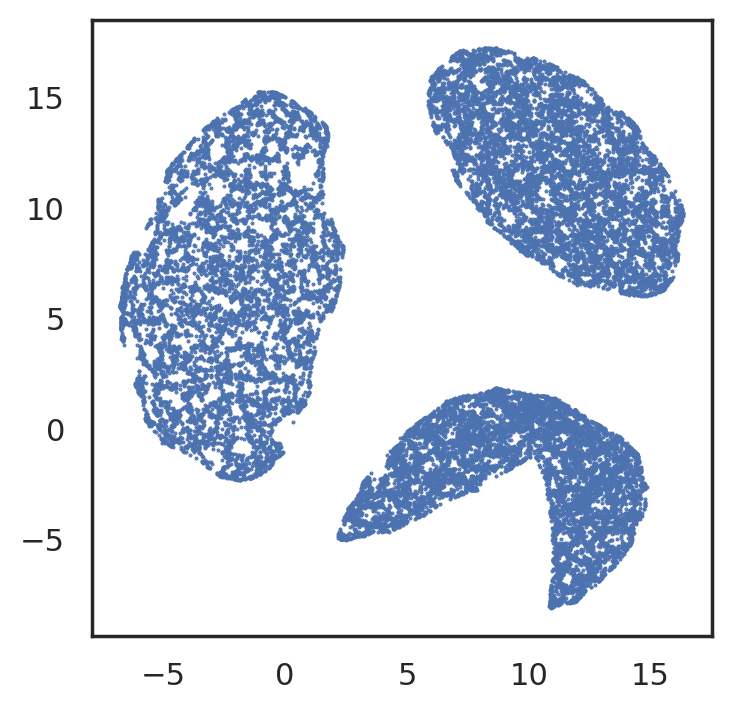

In [32]:
f = plt.figure(figsize=(4,4), dpi=200)
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], s=0.2);

In [33]:
reducer3d = umap.UMAP(n_components=3)

In [34]:
embedding3d = reducer3d.fit_transform(scaled_data)

In [35]:
fig = go.Figure(data=[go.Scatter3d(x=embedding3d[:,0],
                                   y=embedding3d[:,1],
                                   z=embedding3d[:,2],
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x0',
                               yaxis_title='x1',
                               zaxis_title='x2'))
fig.show()

In [36]:
tsne3d = TSNE(n_components=3, n_jobs=4)
X_tsne3d = tsne3d.fit_transform(scaled_data)

In [37]:
fig = go.Figure(data=[go.Scatter3d(x=X_tsne3d[:,0],
                                   y=X_tsne3d[:,1],
                                   z=X_tsne3d[:,2],
                                   mode='markers',
                                   marker=dict(size=1))
                     ])
fig.update_layout(autosize=False,
                  width=800,
                  height=800,
                  margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
                  scene = dict(xaxis_title='x0',
                               yaxis_title='x1',
                               zaxis_title='x2'))
fig.show()